In [1]:
!pip list

Package                Version
---------------------- -------------------
absl-py                0.10.0
altair                 4.1.0
astor                  0.8.1
astunparse             1.6.3
async-generator        1.10
attrs                  20.2.0
backcall               0.2.0
base58                 2.0.1
bleach                 3.2.1
blinker                1.4
boto3                  1.16.7
botocore               1.19.7
brotlipy               0.7.0
cachetools             4.1.1
certifi                2020.12.5
cffi                   1.14.3
chardet                3.0.4
click                  7.1.2
cloudpickle            1.3.0
colorama               0.4.4
conda                  4.9.2
conda-package-handling 1.7.2
cryptography           3.1.1
cycler                 0.10.0
decorator              4.4.2
defusedxml             0.6.0
dm-tree                0.1.5
docopt                 0.6.2
entrypoints            0.3
enum-compat            0.0.3
gast                   0.3.3
gitdb                 

In [2]:
import numpy as np
import scipy as sp
from scipy import sparse
from scipy.spatial import cKDTree
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
%matplotlib notebook
#from IPython.display import display, clear_output
from IPython.display import HTML
#HTML(ani.to_jshtml())

<IPython.core.display.Javascript object>


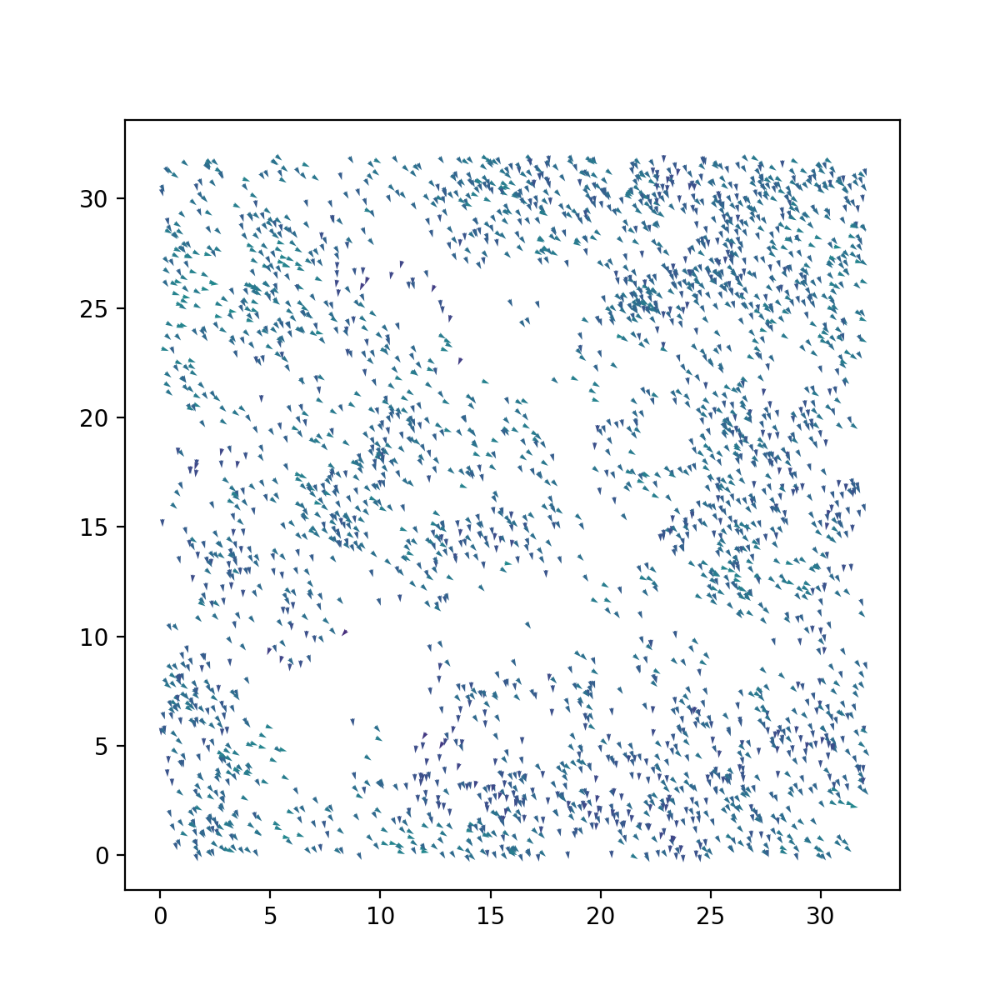

1
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107


Animation size has reached 21041121 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199


In [3]:
L = 32.0
rho = 3.0
N = int(rho*L**2)
#print(" N",N)
 
r0 = 1.0
deltat = 1.0
factor =0.5
v0 = r0/deltat*factor
iterations = 10000
eta = 0.15

pos = np.random.uniform(0,L,size=(N,2))
orient = np.random.uniform(-np.pi, np.pi,size=N)
 
fig, ax= plt.subplots(figsize=(6,6))
 
qv = ax.quiver(pos[:,0], pos[:,1], np.cos(orient[0]), np.sin(orient), orient, clim=[-np.pi, np.pi])

def animate(i):
    print(i)
 
    global orient
    tree = cKDTree(pos,boxsize=[L,L])
    dist = tree.sparse_distance_matrix(tree, max_distance=r0,output_type='coo_matrix')
 
    #important 3 lines: we evaluate a quantity for every column j
    data = np.exp(orient[dist.col]*1j)
    # construct  a new sparse marix with entries in the same places ij of the dist matrix
    neigh = sparse.coo_matrix((data,(dist.row,dist.col)), shape=dist.get_shape())
    # and sum along the columns (sum over j)
    S = np.squeeze(np.asarray(neigh.tocsr().sum(axis=1)))
     
     
    orient = np.angle(S)+eta*np.random.uniform(-np.pi, np.pi, size=N)
 
 
    cos, sin= np.cos(orient), np.sin(orient)
    pos[:,0] += cos*v0
    pos[:,1] += sin*v0
 
    pos[pos>L] -= L
    pos[pos<0] += L
 
    qv.set_offsets(pos)
    qv.set_UVC(cos, sin,orient)
    return qv,

ani = FuncAnimation(fig,animate,np.arange(1, 200),interval=1, blit=True)
HTML(ani.to_jshtml())